In [1]:
import gymnasium as gym
env = gym.make('Ant-v4', render_mode="rgb_array")

In [2]:
env.observation_space

Box(-inf, inf, (27,), float64)

In [3]:
env.action_space

Box(-1.0, 1.0, (8,), float32)

<b> DDPG

In [4]:
import gymnasium as gym
import numpy as np

from stable_baselines3 import TD3
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise

# The noise objects for DDPG
n_actions = env.action_space.shape[-1]
action_noise = OrnsteinUhlenbeckActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))

model = TD3("MlpPolicy", env, action_noise=action_noise, verbose=1, device='cuda')
model.learn(total_timesteps=200000, log_interval=50)
# model.save("TD3_HumanoidStandup")


Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 869      |
|    ep_rew_mean     | 563      |
| time/              |          |
|    episodes        | 50       |
|    fps             | 113      |
|    time_elapsed    | 384      |
|    total_timesteps | 43468    |
| train/             |          |
|    actor_loss      | -34.3    |
|    critic_loss     | 4.67     |
|    learning_rate   | 0.001    |
|    n_updates       | 43367    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 930      |
|    ep_rew_mean     | 692      |
| time/              |          |
|    episodes        | 100      |
|    fps             | 113      |
|    time_elapsed    | 821      |
|    total_timesteps | 93011    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     

In [5]:
model.save("TD3_Ant")

In [6]:
vec_env = model.get_env()

del model

model = TD3.load("TD3_Ant")

obs = vec_env.reset()

c:\Users\gmita\anaconda3\envs\deep\lib\site-packages\torch\_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [7]:
img_array = []
obs = vec_env.reset()
while True :
    action, _states = model.predict(obs)
    obs, rewards, dones, info = vec_env.step(action)
    img = vec_env.render("rgb_array")
    img_array.append(img)

    if dones:
        break
env.close()

In [8]:
from PIL import Image
from IPython.display import display, Image as IPImage
from io import BytesIO

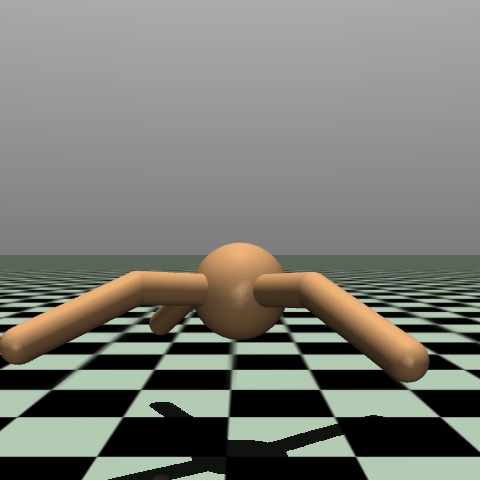

In [9]:
frames = []

# Iterate over the image array and convert each pixel array to a PIL Image object
for pixel_array in img_array:
    # Convert the pixel array to a PIL Image object
    img = Image.fromarray(np.uint8(pixel_array))
    frames.append(img)

gif_data = BytesIO()
frames[0].save(gif_data, format='GIF', append_images=frames[1:], save_all=True, duration=100, loop=0)

# Display the animated GIF inline
display(IPImage(data=gif_data.getvalue(), format='png'))